In [1]:
# watermark the notebook
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3' 

import sys
import tensorflow.keras
import scipy as sp
import tensorflow as tf
import platform
import numpy as np
import matplotlib.pyplot as plt

print(f"Python Platform: {platform.platform()}")
print(f"Tensor Flow Version: {tf.__version__}")
print(f"Keras Version: {tensorflow.keras.__version__}")
print()
print(f"Python {sys.version}")

gpus = tf.config.list_physical_devices('GPU')
print("GPU Resources Available:\n\t",gpus)

# getting rid of the warning messages about optimizer graph
tf.get_logger().setLevel('ERROR')
tf.autograph.set_verbosity(3)


Python Platform: macOS-14.2-arm64-arm-64bit
Tensor Flow Version: 2.12.0
Keras Version: 2.12.0

Python 3.8.16 (default, Mar  1 2023, 21:18:45) 
[Clang 14.0.6 ]
GPU Resources Available:
	 [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


# Visualizing Convolutional Neural Networks

*Code samples adapted from Francois Chollet:*
https://github.com/fchollet/deep-learning-with-python-notebooks/

*SMU Contributors: Ian Stenbit, Eric C. Larson*

Deep learning models are frequently treated with a "black-box" mentality: users simply care about output and don't care to take a look inside to see what's going on. Since convolutional neural networks are, abstractly speaking, "representations of visual concepts" (Chollet), they are viable for visualization.

There are numerous ways to visualize the underlying structure and state of a CNN. Chollet explores 3 particularly useful and intuitive techniques for visualizing convolutional networks:
* Visualizing intermediate outputs / activations
* Visualizing convolutional filters
* Visualizing heatmaps of class activations in input images (for classification CNNs only)



### Loading a Model

The following visualization code is adapted from Chollet's Jupyter Notebooks for his book:
 https://github.com/fchollet/deep-learning-with-python-notebooks/

In [2]:
from tensorflow.keras.models import load_model

model = load_model('models/cats_and_dogs_small_2.h5')

# set model to be frozen (no reason to update any params)
for layer in model.layers:
    layer.trainable = False

model.summary()  # As a reminder.

Metal device set to: Apple M2
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_21 (Conv2D)          (None, 148, 148, 32)      896       
                                                                 
 max_pooling2d_21 (MaxPoolin  (None, 74, 74, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_22 (Conv2D)          (None, 72, 72, 64)        18496     
                                                                 
 max_pooling2d_22 (MaxPoolin  (None, 36, 36, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_23 (Conv2D)          (None, 34, 34, 128)       73856     
                                                                 
 max_pooling2d_23 (MaxPool

### Loading and Formatting an Image

Here we load an image to use for our visualization. Feel free to try an image of your own choosing.

(1, 150, 150, 3)


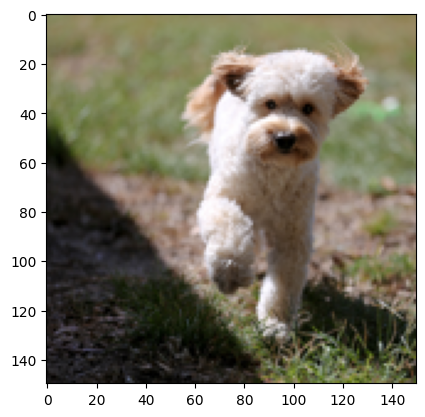

In [3]:
img_url = 'https://raw.githubusercontent.com/8000net/LectureNotes/master/images/dog.jpg'

# We preprocess the image into a 4D tensor
#from keras.preprocessing import image
import numpy as np
import requests
from io import BytesIO
from PIL import Image

def load_image_as_array(url, size=(150, 150)):
    response = requests.get(url) # download
    img = Image.open(BytesIO(response.content)) # open
    img = img.resize(size) # resize with PIL
    return np.array(img).astype(float) # return as numpy float array

def prepare_image_for_display(img, norm_type='max'):
    if norm_type == 'max':
        # min/max scaling, best for regular images
        new_img = (img - img.min()) / (img.max()-img.min())
    else:
        # std scaling, best when we are unsure about large outliers
        new_img = ((img - img.mean()) / (img.std() +1e-3))*0.15 + 0.5
        
    new_img *= 255
    new_img = np.clip(new_img, 0, 255)
    
    if len(new_img.shape)>3:
        new_img = np.squeeze(new_img)
        
    return new_img.astype('uint8')
    

img_tensor = load_image_as_array(img_url)
img_tensor = np.expand_dims(img_tensor, axis=0)
# Remember that the model was trained on inputs
# that were preprocessed in the following way:
img_tensor /= 255.

# Its shape is (1, 150, 150, 3)
print(img_tensor.shape)

import matplotlib.pyplot as plt

plt.imshow(prepare_image_for_display(img_tensor))
plt.show()

# Visualizing Intermediate Activations

Given an arbitrary input to a CNN, we can visualize the activation of each layer of the network by displaying the feature maps that are output by each layer of the network. For each layer, there is a 3-dimensional feature map which can be visualized as a set of 2D images, one for each channel. The resulting images are representations of the filter activations of individual channels in a convolutional or pooling layer. Chollet uses the following example of a cat image to visualize the contents of a CNN used to descriminate between cats and dogs.


### Visualizing the Activation of a Channel

Now that we've loaded an image to visualize the network with, we can create a Model that accepts inputs of image batches and returns outputs of all the layers of the original network.

"To do this, we will use the Keras class Model. A Model is instantiated using two arguments: an input tensor (or list of input tensors), and an output tensor (or list of output tensors). The resulting class is a Keras model, just like the Sequential models that you are familiar with, mapping the specified inputs to the specified outputs. What sets the  Model class apart is that it allows for models with multiple outputs, unlike Sequential. For more information about the Model class, see Chapter 7, Section 1." (Chollet)

In [5]:
from tensorflow.keras import models

# Extracts the outputs of the top 8 layers:
layer_outputs = [layer.output for layer in model.layers[:8]]

# Creates a model that will return these outputs, given the model input:
activation_model = models.Model(inputs=model.input, outputs=layer_outputs)

# This will return a list of Numpy arrays:
# one array per layer activation
activations = activation_model.predict(img_tensor)
print(len(activations))

[print(x.shape) for x in activations]


1/1 [==============================] - 0s 85ms/step
8
(1, 148, 148, 32)
(1, 74, 74, 32)
(1, 72, 72, 64)
(1, 36, 36, 64)
(1, 34, 34, 128)
(1, 17, 17, 128)
(1, 15, 15, 128)
(1, 7, 7, 128)


[None, None, None, None, None, None, None, None]

Notice that this is not a traditional Keras model in that there are multiple outputs. Generally speaking, Keras supports an arbitrary number of inputs and outputs to a model. We will use this property to access different activations in the model, with each of the activations being numpy matrix of the activations.

### Visualizing a Single Channel

Using this multi-output model, we can visualize the activation of any arbitrary channel of any layer of the network. For example, here is a channel of the first layer that appears to function as a diagonal edge detector.

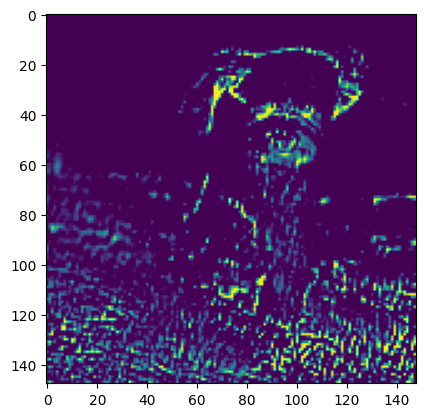

In [11]:
idx_filter = 10
first_layer_activation = activations[0] # get activation from list
one_channel = first_layer_activation[0, :, :, idx_filter] # get single activation channel
plt.imshow(prepare_image_for_display(one_channel,
                                     norm_type = 'std'))
# plt.title(f'Activation (i.e., output) of ${idx_filter}^\{th\}$ filter in the first layer.')
plt.show()

This can be extended to visualize every channel of every layer in the network, which gives us eyes into the black box of the convolutional cats-and-dogs network. The following code (Chollet) plots every single channel side-by-side for each layer of the network.

### Visualizing the Entire Network's Activations

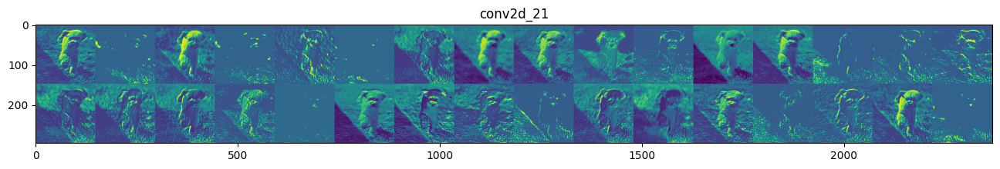

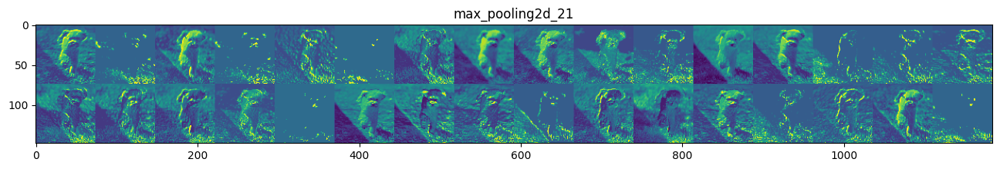

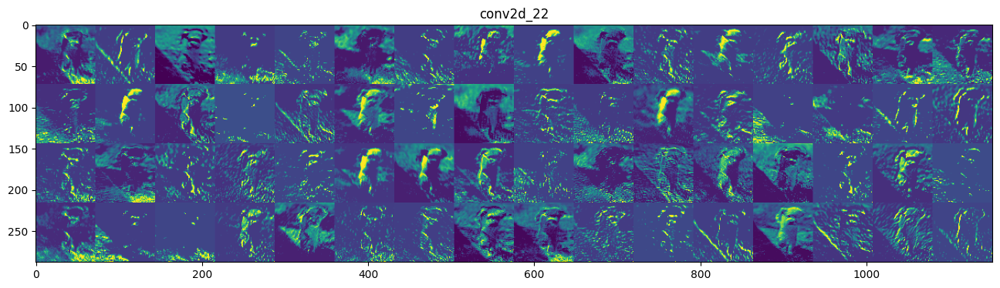

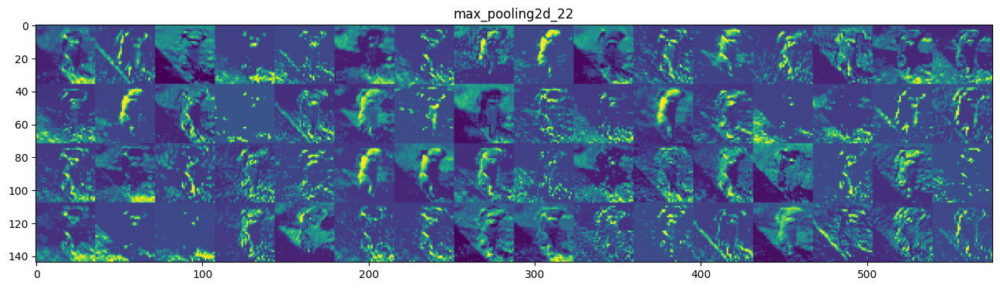

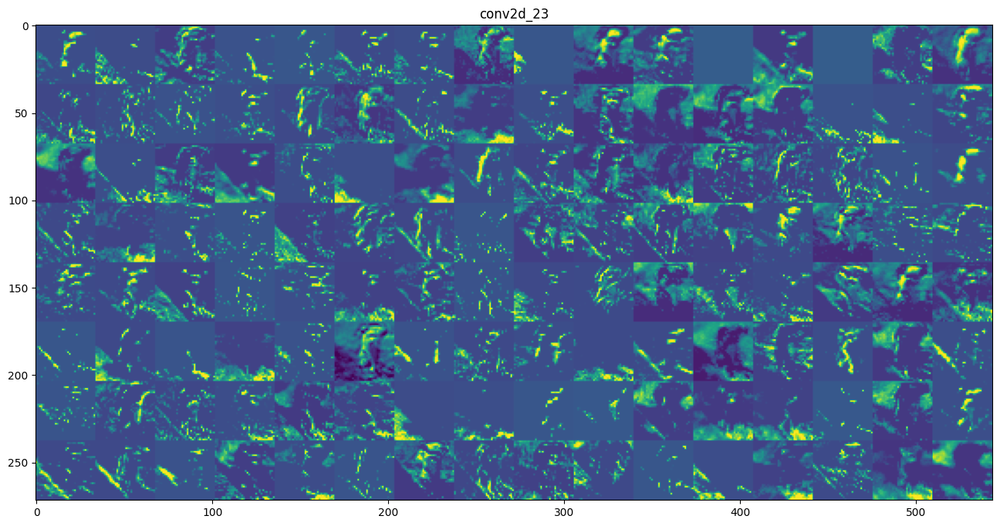

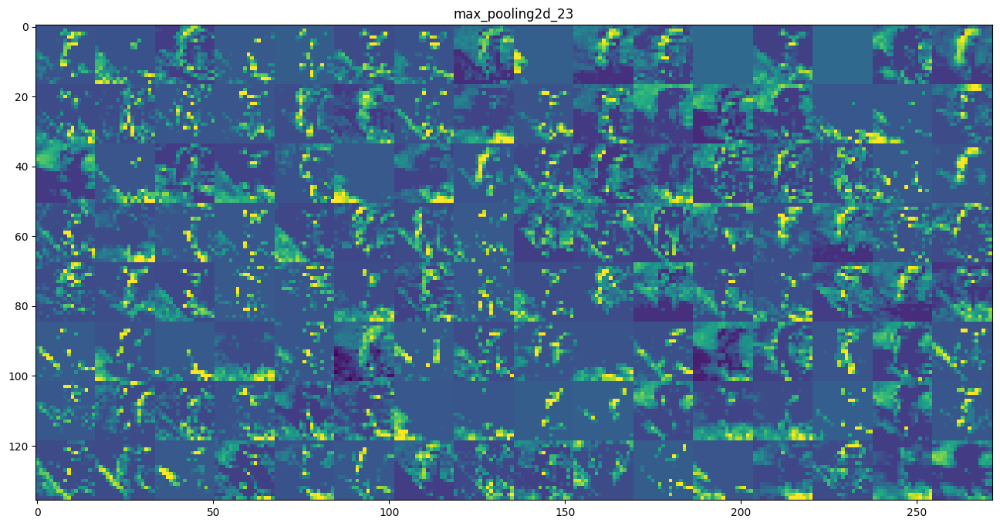

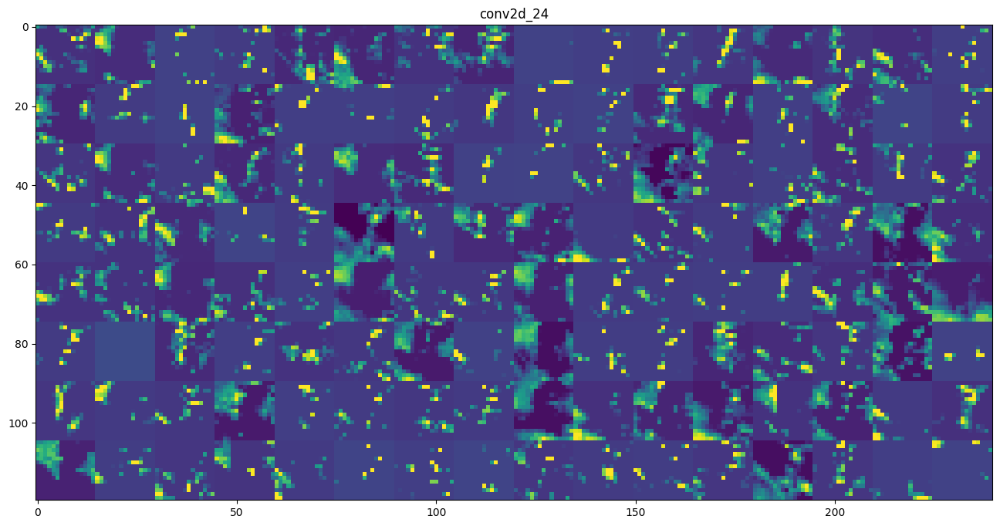

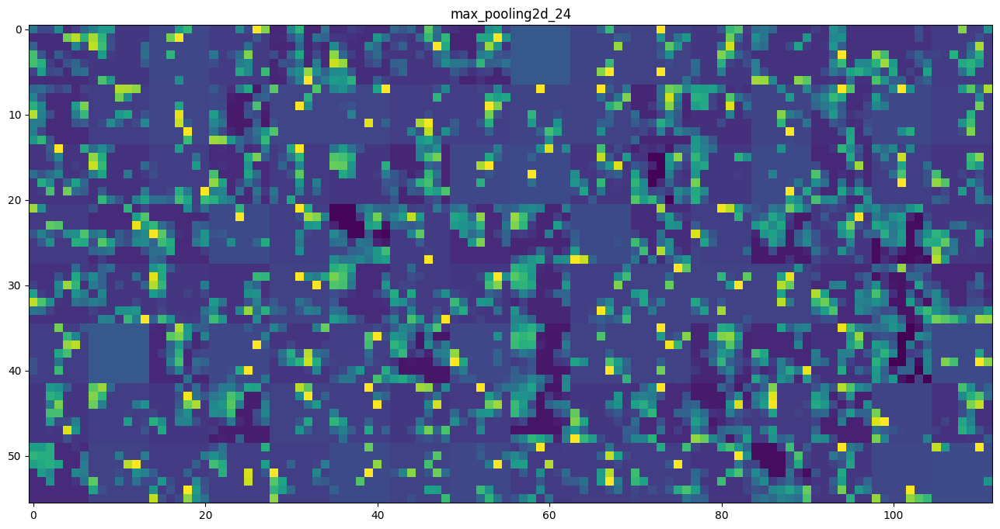

In [6]:
import keras

# These are the names of the layers, so can have them as part of our plot
layer_names = []
for layer in model.layers[:8]:
    layer_names.append(layer.name)

images_per_row = 16

# Now let's display our feature maps (the activations variable is from the model.predict above)
for layer_name, layer_activation in zip(layer_names, activations):
    # This is the number of features in the feature map
    n_features = layer_activation.shape[-1]

    # The feature map has shape (1, size, size, n_features)
    size = layer_activation.shape[1]

    # We will tile the activation channels in this matrix
    n_cols = n_features // images_per_row
    display_grid = np.zeros((size * n_cols, images_per_row * size))

    # We'll tile each filter into this big horizontal grid
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0,
                                             :, :,
                                             col * images_per_row + row]
            # Post-process the feature to make it visually palatable
            channel_image = prepare_image_for_display(channel_image,
                                     norm_type = 'std')
            display_grid[col * size : (col + 1) * size,
                         row * size : (row + 1) * size] = channel_image

    # Display the grid
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')
    
plt.show()

### Observations

Notice that as we move downward through this figure, into deeper layers of the network, the activations retain less and less of the original input content. The channels serve primarily as edge detectors and the like, while later layers retain very little of the original form of the image. Moreover, in some later layers, there is no activation. For example, in max_pooling2d_23, there are two channels with no activation. This indicates that the pattern represented by that channel is not present in the source image.

It is important to identify that, as you move deeper into the network, the features that activate a given channel become more and more abstract. Chollet describes this behaviour by comparing a convolutional neural network to an **information distillation pipeline**, which iteratively transforms raw data such that irrelevant information is "filtered out and useful information is magnified."

I encourage you to try your own image of a dog or cat and examine the activations with that image. Spend some time looking at what all the activations look like. Can you identify any high-level abstract concepts that are identified by later-level layers? Perhaps dog ears or cat eyes?

## Live Demo Activations.py [scripts are deprecated]
Now let's look at analyzing this through the WebCam for VGG. You can run the following scripts in python assuming you have OpenCV installed.

`cd activation-demo`

`python Activations.py`


# [Back to Slides]

___

# Visualizing Convolutional Filters in VGG16

We can also perform the inverse operation, in some sense, by synthesizing images to maximize the response from a specific filter. This allows us to visualize the pattern that a given channel responds to. This can be performed with gradient ascent, a process wherein you perform gradient descent on the input image to a network, starting with a blank image. The final result image, in an optimal gradient ascent, is maximally activating of the chosen filter.

Chollet performs this with the following code, which utliizes stochastic gradient descent to synthesize an image which maximally activates an arbitrary filter

$$
I \leftarrow I+ \eta \sum_{i,j}\nabla f_n(I)_{i,j} 
$$

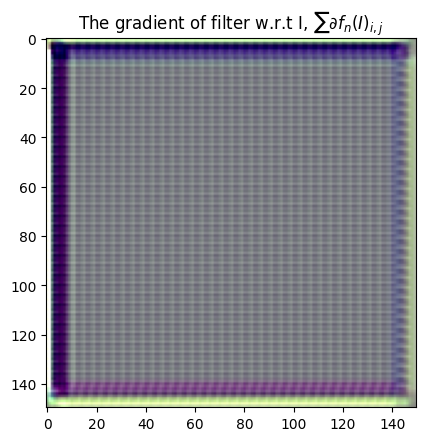

In [12]:
from tensorflow.keras.applications import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input

# Load the pre-trained VGG16 model
model = VGG16(weights='imagenet', include_top=False, input_tensor=None)

# set VGG to be frozen
for layer in model.layers:
    layer.trainable = False

# Selecting a layer and channel to visualize
layer_name = 'block3_conv1'
filter_index = 0
 
# Isolate the output of interest and create new model
layer_output = model.get_layer(layer_name).output
new_model = models.Model(inputs=model.input, outputs=layer_output)
# now "new_model" has the output we desire to maximize

# create a variable that we can access and update in computation graph
I = tf.Variable(np.zeros((1, 150, 150, 3),dtype='double'), name='image_var', dtype = 'float64')

# now use gradient tape to get the gradients (watching only the variable v)
with tf.GradientTape(watch_accessed_variables=False) as tape:
    tape.watch(I) # watch
    model_vals = new_model(preprocess_input(I)) # get output
    filter_output_to_maximize = tf.reduce_mean(model_vals[:, :, :, filter_index]) # define what we want to maximize
    
grad_fn = tape.gradient(filter_output_to_maximize, I) # get gradients that influence loss w.r.t. v
grad_fn /= (tf.sqrt(tf.reduce_mean(tf.square(grad_fn))) + 1e-5) # mean L2 norm (better stability)

# now show the gradient, same size as input image
plt.imshow(prepare_image_for_display( grad_fn.numpy(), norm_type='std'))
plt.title('The gradient of filter w.r.t I, $ \sum\partial f_n(I)_{i,j} $ ')
plt.show()

When we perform gradient descent and iteratively update the blank image, the result is not guaranteed to be a valid, displayable image. We can fix that using our previous prepare for display function, with STD scaling.

### A Generic Function for Filter Activation Optimization

Using this deprocess_image utility function, and the code above, we can write a generalized function to generate an optimal image for activating any arbitrary filter in the network. Notice the additonal code at the bottom of the function which, for 40 iterations, performs gradient ascent on the input image to adjust it to maximize filter activation.
$$
I \leftarrow I+ \eta \sum_{i,j}\nabla f_n(I)_{i,j} 
$$

In [13]:
def generate_pattern(layer_name, filter_index, size=150):
    # Build a model that outputs the activation
    # of the nth filter of the layer considered.
    layer_output = model.get_layer(layer_name).output
    # Isolate the output 
    new_model = models.Model(inputs=model.input, outputs=layer_output)
    
    # We start from a gray image with some uniform noise
    input_img_data = np.random.random((1, size, size, 3)) * 20 + 128.
    
    I_start = tf.Variable(input_img_data, name='image_var', dtype = 'float64')
    I = preprocess_input(I_start) # only process once
    # Run gradient ascent for 40 steps
    eta = 1.
    for i in range(40):
        with tf.GradientTape(watch_accessed_variables=False) as tape:
            tape.watch(I)
            # get variable to maximize 
            model_vals = new_model(I) 
            loss = tf.reduce_mean(model_vals[:, :, :, filter_index])

        # Compute the gradient of the input picture w.r.t. this loss
        # add this operation input to maximize
        grad_fn = tape.gradient(loss, I)
        # Normalization trick: we normalize the gradient
        grad_fn /= (tf.sqrt(tf.reduce_mean(tf.square(grad_fn))) + 1e-5) # mean L2 norm
        I += grad_fn * eta # one iteration of maximizing
        
    # return the numpy matrix so we can visualize 
    img = I.numpy()
    return prepare_image_for_display(img, norm_type='std')

### Visualizing a Single Filter

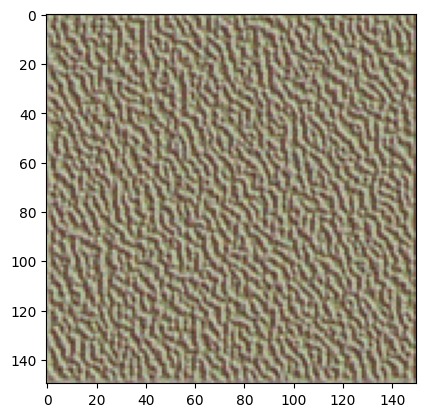

In [16]:
plt.imshow(generate_pattern('block1_conv1', 6))
plt.show()

### Visualizing the Entire Network's Filters

This can be repeated for any filter in the network. The following code from Chollet plots 64 of the filters from each convolutional layer, with black margins between them in 4 8x8 grids of filters. 

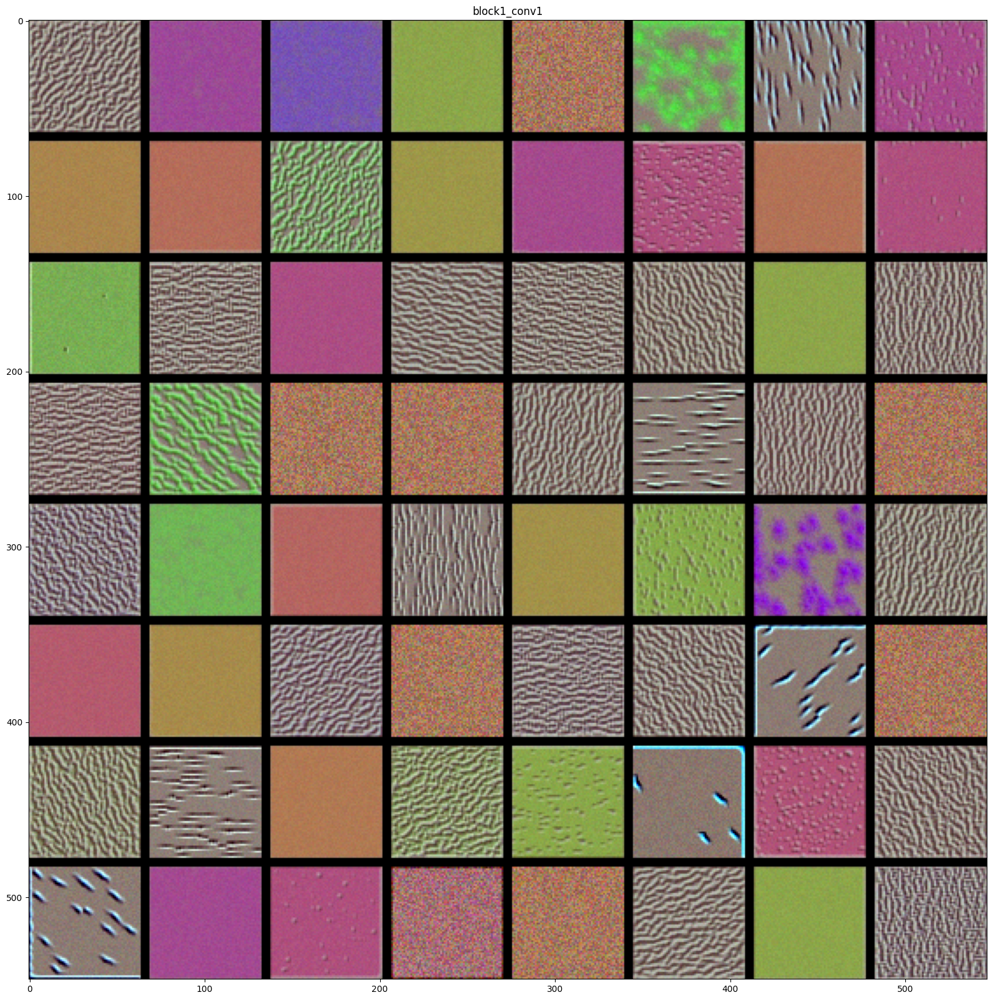

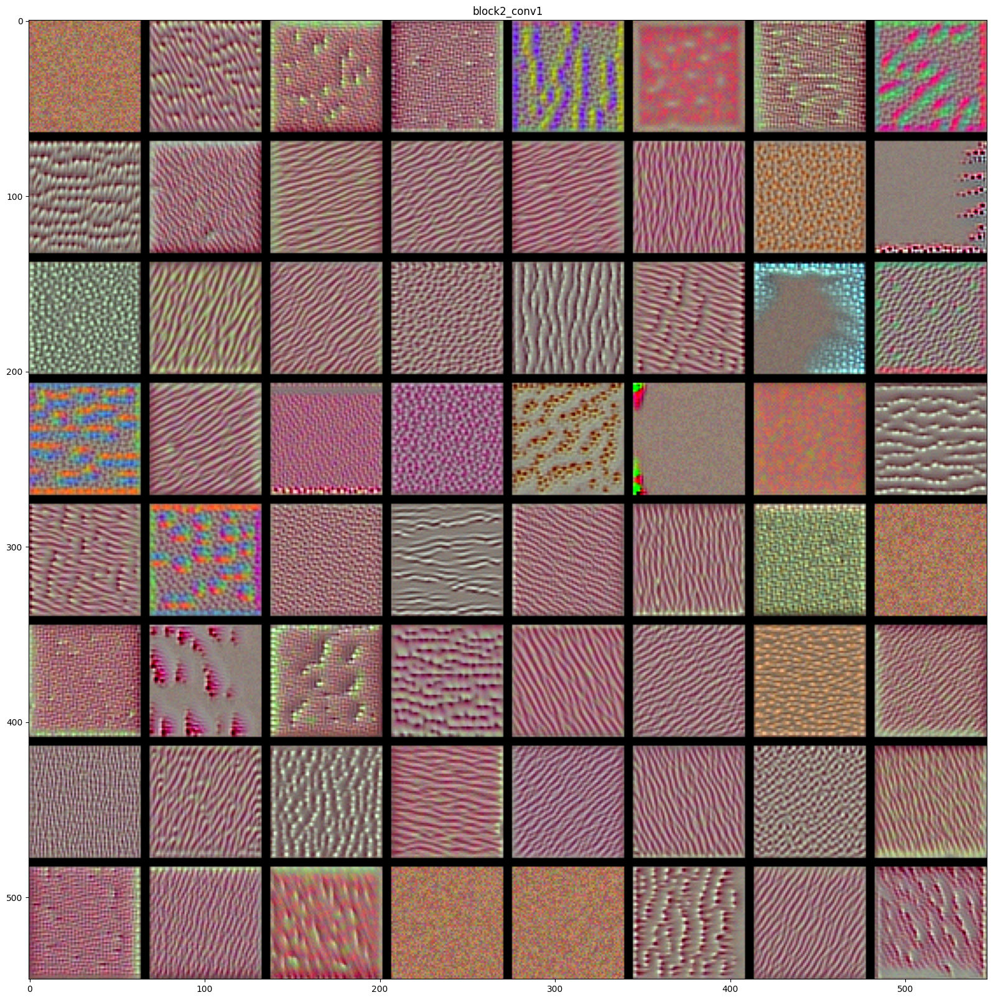

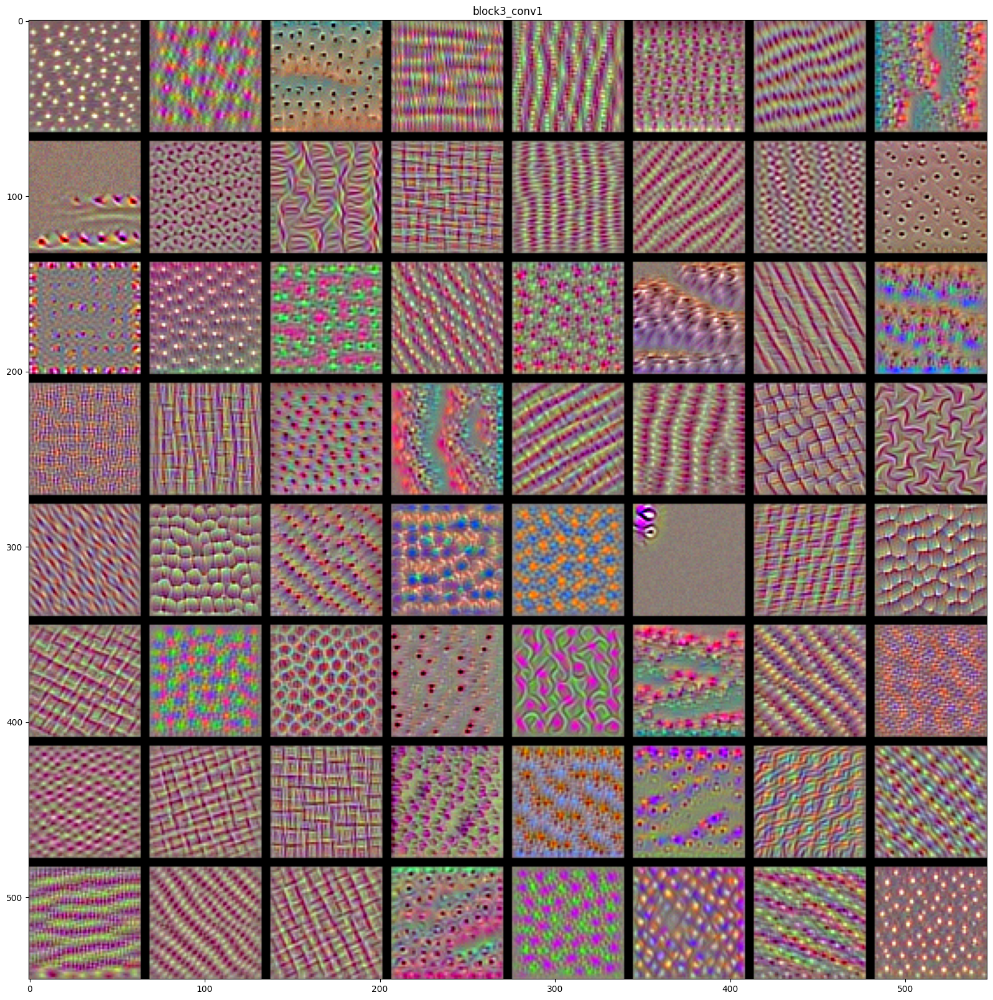

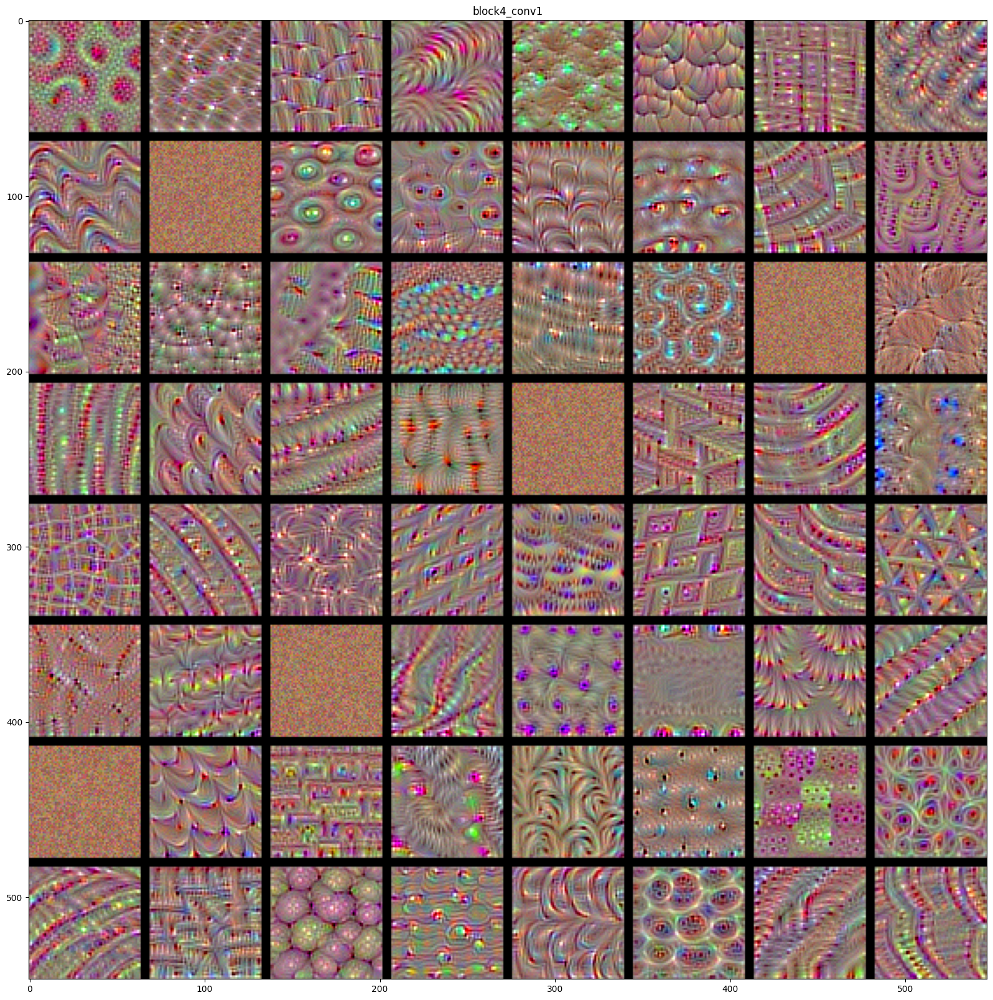

In [10]:
for layer_name in ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1']:
    size = 64
    margin = 5

    # This a empty (black) image where we will store our results.
    results = np.zeros((8 * size + 7 * margin, 8 * size + 7 * margin, 3)).astype('uint8')

    for i in range(8):  # iterate over the rows of our results grid
        for j in range(8):  # iterate over the columns of our results grid
            # Generate the pattern for filter `i + (j * 8)` in `layer_name`
            filter_img = generate_pattern(layer_name, i + (j * 8), size=size)
            # Put the result in the square `(i, j)` of the results grid
            horizontal_start = i * size + i * margin
            horizontal_end = horizontal_start + size
            vertical_start = j * size + j * margin
            vertical_end = vertical_start + size
            results[horizontal_start: horizontal_end, vertical_start: vertical_end, :] = filter_img

    # Display the results grid
    plt.figure(figsize=(20, 20))
    plt.imshow(results)
    plt.title(layer_name)
    plt.show()

### Observations

Notice that the trend observed in the first set of visualizations is very evident here: as we move into deeper layers of the network, the convolutional filters resemble increasingly abstract ideas (like going from lines to curves to texttures). The first layer consists of primarily simple textures, and the filters get increasingly complex until we reach the final layer, where filters have abstract meanings recognizable to the human eye (feathers, eyes, bricks, etc.)

### Going Beyond the Demo:
Now try to manipulate the above code to generate images like **DeepDream**. To achieve this:
- Implement a "random shift" process for adding noise into the image
- Implement L1 normalization of the gradient
- Implement clipping during the iteration process


# [Back To Slides]

___

# Classification Activation Heatmaps

For classification CNNs, it can be useful to identify which parts of an input image have the most influence in the final output classification. This general technique of visualization is referred to as Class Activation Maps (CAMs), and we will use Chollet's implementation of [Grad-CAM: Why did you say that? Visual Explanations from Deep Networks via Gradient-based Localization](https://arxiv.org/abs/1610.02391) to show some examples of CAMs for VGG16.

In [17]:
from tensorflow.keras.applications.vgg16 import VGG16

# Note that we are including the densely-connected classifier on top;
# all previous times, we were discarding it.
model = VGG16(weights='imagenet')

# set VGG to be frozen
for layer in model.layers:
    layer.trainable = False

model.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

### Formatting an Image for VGG

Now we will use some pre-processing code to convert an arbitrary image into the correct format for VGG. The sample input image here is of Dallas Hall and lawn on a sunny day.

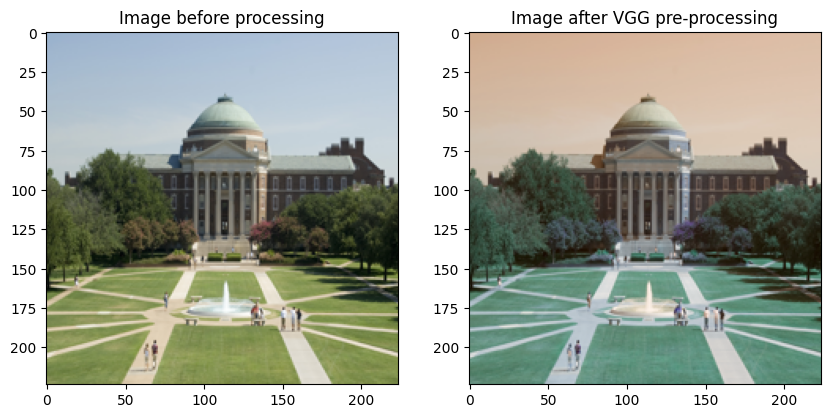

In [18]:
# from keras.preprocessing import image
from tensorflow.keras.applications.vgg16 import preprocess_input, decode_predictions
# import numpy as np
# from matplotlib import pyplot as plt
# %matplotlib inline

# import requests
# from io import BytesIO
# from PIL import Image

def load_image_as_array(url, size=(150, 150)):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content))
    img = img.resize(size)
    return np.array(img).astype(float)

# The local path to our target image
img_url = 'https://raw.githubusercontent.com/8000net/LectureNotes/master/images/dallas_hall.jpg'

img = load_image_as_array(img_url, size=(224, 224))
x = np.expand_dims(img, axis=0)

# We add a dimension to transform our array into a "batch"
# of size (1, 224, 224, 3)
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.imshow(prepare_image_for_display(x))
plt.title('Image before processing')

# Finally we preprocess the batch
# (this normalizes according to VGG training)
x = preprocess_input(x)

plt.subplot(1,2,2)
plt.imshow(prepare_image_for_display(x))
plt.title('Image after VGG pre-processing')
plt.show()

### Getting a Prediction from VGG

1/1 [==============================] - 0s 212ms/step
Predicted: [('n03733281', 'maze', 0.7187892), ('n03877845', 'palace', 0.12836632), ('n04355338', 'sundial', 0.06970542)]
835
698
646


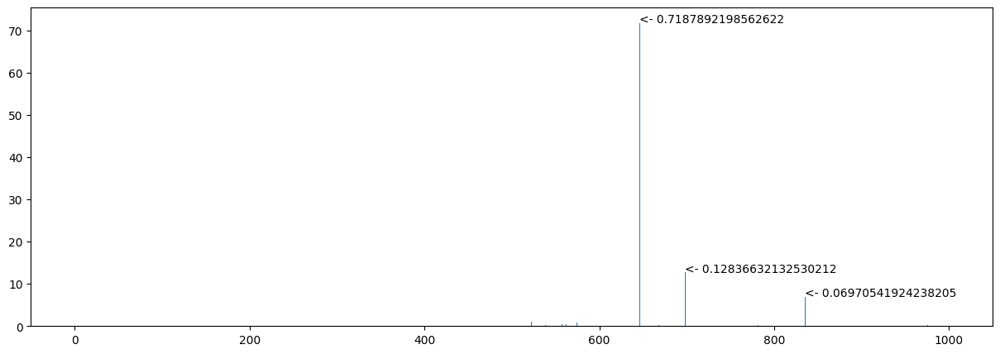

In [19]:
preds = model.predict(x)
print('Predicted:', decode_predictions(preds, top=3)[0])

predicted_class = np.argmax(preds)

# show the predictions
plt.figure(figsize=(15,5)) # try to eliminate aliasing
preds = np.squeeze(preds)
index = np.arange(len(preds)) + 0.3
plt.bar(index, preds*100 )
for idx in np.argsort(preds)[-3:]: # top 3 predictions indices
    print(idx)
    txt = f'<- {preds[idx]}'
    plt.text(index[idx], preds[idx]*100, txt)

plt.show()

In [20]:
topk_idx = np.argsort(preds)[-3:] # top 3 predictions indices
print(topk_idx)

[835 698 646]


The model interprets Dallas Hall (and lawn) to be a palace. (A reasonable prediction, if you ask me)

### Creating an Activation Heatmap

To visualize why the maximal class was chosen, we use the following Grad-CAM implementation from Chollet. Grad-CAM is a visualization technique originally invented by [Selvaraju, et. al ](https://arxiv.org/pdf/1610.02391.pdf) which uses the gradient of the predicted class at the final convolutional layer to generate a map of pixel locations on the input image which cause the relevant predicted class to be chosen.

We will use the following in our analysis:
$$ \alpha_k^c =\frac{1}{|I\times J|} \sum_{i,j}\frac{\partial f_c(I)}{\partial A_{i,j,k}^{(L)}} 
$$
and
$$
S_{i,j} = \frac{1}{S_{max}}\sum_k \alpha_k^c A_{i,j,k}^{(L)}
$$


In [31]:
def grad_cam(img, class_idx=None):
    # The is the output feature map of the `block5_conv3` layer,
    # the last convolutional layer in VGG16
    # this is A_{i,j,k} (in keras tensor form) above
    Aijk_as_kt = model.get_layer('block5_conv3').output
    # make new model with access to various layers of interest
    new_model = models.Model(inputs=model.input, 
                             outputs=[Aijk_as_kt, model.output])

    # create a variable with the image data
    I = np.expand_dims(img, axis=0)

    # now use gradient tape to get the gradients (watching only the variable v)
    with tf.GradientTape(watch_accessed_variables=True) as tape:
        Aijk_as_tf, fc_as_tf = new_model(I) # get outputs
        
        if class_idx == None:
            # just get maximum class, if not set by user
            class_idx = np.argmax(fc_as_tf) 
            
        sum_fc = tf.reduce_mean(fc_as_tf[:, class_idx]) # define what we want to maximize

    # This is the gradient of the predicted class with regard to
    # the output feature map of `block5_conv3`
    # this is the df / dA above
    grad_fc_wrt_Aijk_as_tf = tape.gradient(sum_fc, Aijk_as_tf) # get gradients that influence loss w.r.t. last conv


    # This is a vector of shape (512,), where each entry
    # is the mean intensity of the gradient over a specific feature map channel
    # this is the alpha values in tensor form
    alpha_k_as_tf = tf.reduce_mean(grad_fc_wrt_Aijk_as_tf, 
                                   axis=(0, 1, 2))
    #                              axis=(Batch x I x J)


    # These are the values of these two quantities, as Numpy arrays,
    # given our sample image
    # these are the numpy outputs for alpha_k and A_{i,j,k}
    alpha_k = alpha_k_as_tf.numpy() # now in numpy form
    A = Aijk_as_tf.numpy() # also get the last layer as numpy


    # We multiply each channel in the feature map array
    # by "how important this channel is" with regard to the predicted class
    # this is alpha*A before it is collapsed with the mean
    for i in range(512):
        A[:, :, :, i] *= alpha_k[i]
        # only highlight positive influences for class
        A[:, :, :, i] = np.maximum(A[:, :, :, i], 0)
        
        # B x I x J x Chan

    # The channel-wise mean of the resulting feature map
    # is our heatmap of class activation
    # this is our S_{i,j} above (before normalizing)
    S = np.sum(A, axis=-1)
    # size of S is now Batch x I x J (summed over channels)

    # We then normalize the heatmap 0-1 for visualization:
    # this is where we account for S_max
    S /= np.max(S)
    return S

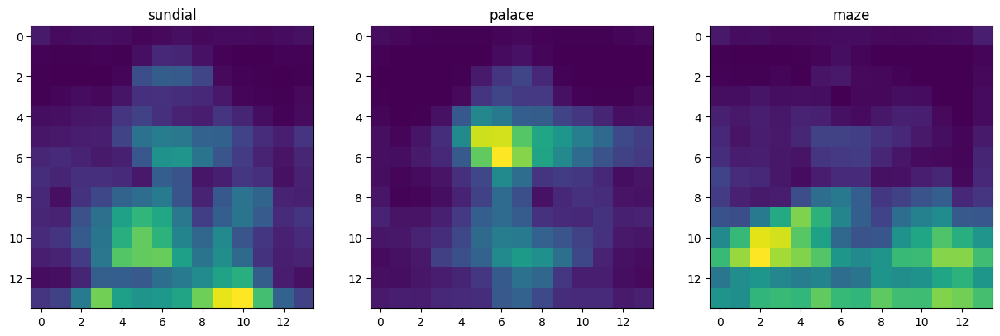

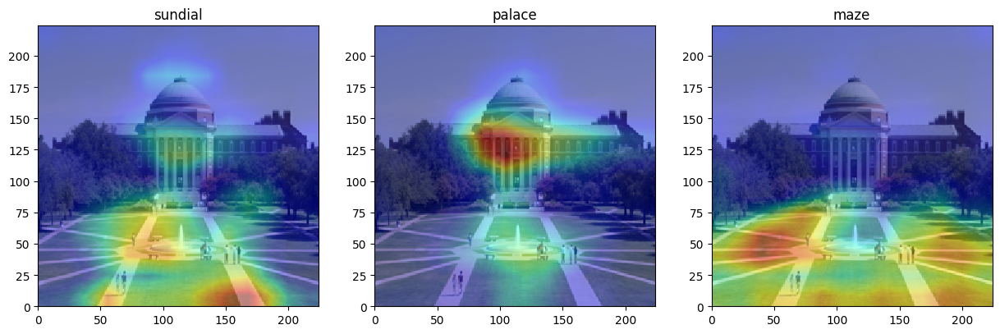

In [32]:
img = load_image_as_array(img_url, size=(224, 224))
extent = (0, 224, 0, 224)

# get class areas for each of top k predictions
all_S = [grad_cam(img, class_idx=idx) for idx in topk_idx]
titles = ['sundial','palace','maze']

# show each heatmap
plt.figure(figsize=(15,5))
for i,idx in enumerate(topk_idx):    
    plt.subplot(1,3,i+1)
    plt.imshow(np.squeeze(all_S[i]))
    plt.title(titles[i])
    
# show overlay of each heatmap
plt.figure(figsize=(15,5),frameon=False)
for i,idx in enumerate(topk_idx):    
    plt.subplot(1,3,i+1)
    
    plt.imshow(img/255, interpolation='nearest', extent=extent)
    # use jet here for color mapping, even though I hate jet
    plt.imshow(np.squeeze(all_S[i]), cmap=plt.cm.jet, alpha=0.4,
               interpolation='bilinear',
               extent=extent)
    
    plt.title(titles[i])
    
plt.show()

### Dallas Hall Lawn Palace Activation, VGG19 on higher resolution

The following heatmap shows that the center of the building's facade is what most identifies it as a palace.

![alt text](images/dallas_hall_palace_heatmap.jpg "Dallas Hall Palace Heatmap")

### Dallas Hall Lawn Maze Activation, VGG19 on higher resolution

VGG also identifies that Dallas Hall looks like a maze. The heatmap of the activation for the maze class shows that the crossing sidewalks are the culprit. This is quite intuitive, as a series of crossing paths is likely to be indicative of a maze.

![alt text](images/dallas_hall_maze_heatmap.jpg "Dallas Hall Maze Heatmap")

### Dallas Hall Lawn Sundial Activation, VGG19 on higher resolution

Finally, VGG identifies that the image may be a sundial. This is a slightly less intuitive reaction to the image (and, accordingly, the sundial class activates to a much lesser degree than the previous classes). However, the class is activated by the fountain and to a lesser extent by the top of the dome on top of Dallas hall. Upon further inspection, it is reasonable to see how those two parts of the image could be confused for a sundial.

![alt text](images/dallas_hall_sundial_heatmap.jpg "Dallas Hall Sundial Heatmap")

### Explore VGG Activation Heatmaps for Yourself

I encourage you to try this with an image of your own choosing and explore the code in detail.

